In [25]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/variantional-autoencoders-vae/__results__.html
/kaggle/input/variantional-autoencoders-vae/__notebook__.ipynb
/kaggle/input/variantional-autoencoders-vae/__output__.json
/kaggle/input/variantional-autoencoders-vae/custom.css
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___39_0.png
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___40_0.png
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___19_0.png
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___53_0.png
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___54_0.png
/kaggle/input/variantional-autoencoders-vae/__results___files/__results___23_0.png
/kaggle/input/gan-getting-started/monet_jpg/f4413e97bd.jpg
/kaggle/input/gan-getting-started/monet_jpg/7341d96c1d.jpg
/kaggle/input/gan-getting-started/monet_jpg/de6f71b00f.jpg
/kaggle/input/gan-getting-started/monet_jpg/99d94af5dd.jpg
/kaggle/input/gan-getting-s

---

# Loading the datasets


In [26]:
import tensorflow as tf
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define the image size
IMG_SIZE = 256
BATCH_SIZE = 1  # CycleGAN typically uses batch size of 1

# Function to preprocess input image
def preprocess_image(image):
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    image = (image - 127.5) / 127.5  # Normalize to [-1, 1]
    return image

# Function to parse images from directory
def load_images(image_dir):
    image_files = [os.path.join(image_dir, filename) for filename in os.listdir(image_dir)]
    dataset = tf.data.Dataset.from_tensor_slices(image_files)
    dataset = dataset.map(lambda x: preprocess_image(tf.image.decode_jpeg(tf.io.read_file(x), channels=3)))
    dataset = dataset.shuffle(buffer_size=1024).batch(BATCH_SIZE)
    return dataset

# Function to parse TFRecord files
def parse_tfrecord_fn(example):
    feature_description = {
        'image': tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example, feature_description)
    image = tf.io.decode_jpeg(example['image'], channels=3)
    image = preprocess_image(image)
    return image

# Load dataset from TFRecord files
def load_tfrecord_dataset(tfrecord_files):
    raw_dataset = tf.data.TFRecordDataset(tfrecord_files)
    parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
    dataset = parsed_dataset.shuffle(buffer_size=1024).batch(BATCH_SIZE)
    return dataset

# Paths to the directories
real_photos_dir = '/kaggle/input/gan-getting-started/photo_jpg/'
monet_tfrecord_dir = '/kaggle/input/gan-getting-started/monet_tfrec/'

# List of TFRecord files with full paths
tfrecord_files = [os.path.join(monet_tfrecord_dir, filename) for filename in os.listdir(monet_tfrecord_dir)]

# Load the datasets
real_photos_dataset = load_images(real_photos_dir)
monet_paintings_dataset = load_tfrecord_dataset(tfrecord_files)


# Building the CycleGAN model


In [27]:
from tensorflow.keras import layers, Model

# Define the generator
def build_generator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

    down_stack = [
        layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.LeakyReLU(),
        layers.Conv2D(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2D(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU()
    ]

    up_stack = [
        layers.Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),
        layers.Conv2DTranspose(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU()
    ]

    last = layers.Conv2DTranspose(3, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', activation='tanh')

    x = inputs
    for down in down_stack:
        x = down(x)
    for up in up_stack:
        x = up(x)
    outputs = last(x)

    return Model(inputs, outputs)

# Define the discriminator
def build_discriminator():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

    x = layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(inputs)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)

    return Model(inputs, x)


# CycleGAN Training


In [28]:
# from IPython.display import clear_output

# # Loss function for both generator and discriminator
# cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# # Discriminator loss
# def discriminator_loss(real_output, fake_output):
#     real_loss = cross_entropy(tf.ones_like(real_output), real_output)
#     fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
#     total_loss = real_loss + fake_loss
#     return total_loss

# # Generator loss
# def generator_loss(fake_output):
#     return cross_entropy(tf.ones_like(fake_output), fake_output)

# # Cycle consistency loss
# def calc_cycle_loss(real_image, cycled_image):
#     loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
#     return loss

# # Identity loss
# def identity_loss(real_image, same_image):
#     loss = tf.reduce_mean(tf.abs(real_image - same_image))
#     return loss

# # Optimizers
# generator_g_optimizer = tf.keras.optimizers.Adam(2e-10, beta_1=0.5)
# generator_f_optimizer = tf.keras.optimizers.Adam(2e-10, beta_1=0.5)
# discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
# discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# # Instantiate the models
# generator_g = build_generator()  # Real photo to Monet
# generator_f = build_generator()  # Monet to real photo
# discriminator_x = build_discriminator()  # Discriminator for Monet
# discriminator_y = build_discriminator()  # Discriminator for real photo

# @tf.function
# def train_step(real_x, real_y):
#     with tf.GradientTape(persistent=True) as tape:
#         # Generator G translates X -> Y
#         fake_y = generator_g(real_x, training=True)
#         cycled_x = generator_f(fake_y, training=True)

#         # Generator F translates Y -> X
#         fake_x = generator_f(real_y, training=True)
#         cycled_y = generator_g(fake_x, training=True)

#         # Same images to identity loss
#         same_x = generator_f(real_x, training=True)
#         same_y = generator_g(real_y, training=True)

#         # Discriminator outputs
#         disc_real_x = discriminator_x(real_x, training=True)
#         disc_real_y = discriminator_y(real_y, training=True)
#         disc_fake_x = discriminator_x(fake_x, training=True)
#         disc_fake_y = discriminator_y(fake_y, training=True)

#         # Generator adversarial loss
#         gen_g_loss = generator_loss(disc_fake_y)
#         gen_f_loss = generator_loss(disc_fake_x)

#         # Cycle consistency loss
#         total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

#         # Total generator loss
#         total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
#         total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

#         # Discriminator loss
#         disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
#         disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

#     # Calculate the gradients
#     generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
#     generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
#     discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
#     discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

#     # Apply the gradients
#     generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
#     generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
#     discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
#     discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

# checkpoint_dir = './checkpoints'
# checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
# checkpoint = tf.train.Checkpoint(generator_g=generator_g,
#                                  generator_f=generator_f,
#                                  discriminator_x=discriminator_x,
#                                  discriminator_y=discriminator_y,
#                                  generator_g_optimizer=generator_g_optimizer,
#                                  generator_f_optimizer=generator_f_optimizer,
#                                  discriminator_x_optimizer=discriminator_x_optimizer,
#                                  discriminator_y_optimizer=discriminator_y_optimizer)

# # Training function
# import time
# def generate_images(model, test_input):
#     prediction = model(test_input, training=True)
#     plt.figure(figsize=(12, 12))

#     display_list = [test_input[0], prediction[0]]
#     title = ['Input Image', 'Generated Image']

#     for i in range(2):
#         plt.subplot(1, 2, i+1)
#         plt.title(title[i])
#         plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
#         plt.axis('off')
#     plt.show()

# def train(real_dataset, monet_dataset, epochs):
#     for epoch in range(epochs):
#         start = time.time()

#         n = 0
#         for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)):
#             train_step(real_x, real_y)
#             if n % 10 == 0:
#                 print('.', end='', flush=True)
#             n += 1

#         print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

#         # Produce images for the GIF as we go
# #         clear_output(wait=True)
#         generate_images(generator_g, sample_real_image)
#         # Save the model every 5 epochs
#         if (epoch + 1) % 20 == 0:
#             print('checkpoint_prefix')
#             checkpoint.save(file_prefix=checkpoint_prefix)

# # Sample images
# sample_real_image = next(iter(real_photos_dataset))


# # Restore the latest checkpoint
# latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
# if latest_checkpoint:
#     checkpoint.restore('./checkpoints/ckpt-16')
#     print(f'Restored from {latest_checkpoint}')
# else:
#     print('Starting training from scratch.')

# # Train the CycleGAN
# EPOCHS = 1
# train(real_photos_dataset, monet_paintings_dataset, EPOCHS)


# Prepare last checkpoint for download

* After the 150 epochs the model seems to start overfitting:
    - we can see that the generator is able to recreate the correct shape fo the image
    - my approach would be to consider the generator at that state and try rfine the training from that point

In [29]:
# # Restore the latest checkpoint
# latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
# if latest_checkpoint:
#     checkpoint.restore(latest_checkpoint)
#     print(f'Restored from {latest_checkpoint}')
# else:
#     print('Starting training from scratch.')

In [30]:
# import shutil


# shutil.make_archive("/kaggle/working/new", 'zip', latest_checkpoint)

# Saving the models

In [31]:
# import os

# # Define the save path
# save_dir = '/kaggle/working/model_'
# if not os.path.exists(save_dir):
#     os.makedirs(save_dir)

# # Define unique filenames
# generator_g_filename = os.path.join(save_dir, 'generator_model_combined_latest.h5')
# generator_f_filename = os.path.join(save_dir, 'generator_model_combined_inverse_latest.h5')

# # Ensure unique filenames by appending a timestamp or unique identifier
# import time
# timestamp = int(time.time())
# generator_g_filename = os.path.join(save_dir, f'generator_model_combined_{timestamp}.h5')
# generator_f_filename = os.path.join(save_dir, f'generator_model_combined_inverse_{timestamp}.h5')

# # Save the models
# combined_generator_g.save(generator_g_filename)
# combined_generator_f.save(generator_f_filename)

# print(f'Models saved to {generator_g_filename} and {generator_f_filename}')



In [32]:
# import shutil


# shutil.make_archive("/kaggle/working/final", 'zip', '/kaggle/working/model')

# Visualization

In [33]:
def generate_images(model, test_input):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Generated Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')
    plt.show()
    return  prediction 

In [34]:
# (p * 127.5 + 127.5).numpy().astype(np.uint8)

# Load model

In [35]:
# Load the saved generator model
loaded_generator = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/generator_model_latest.h5')
# loaded_generator = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/enhancedcolors/1/generator_model_enhanced.h5')

# Load the saved discriminator model
# loaded_discriminator = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/1_first_train/1/discriminator_model.h5')
loaded_discriminator = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/discriminator_model_latest.h5')



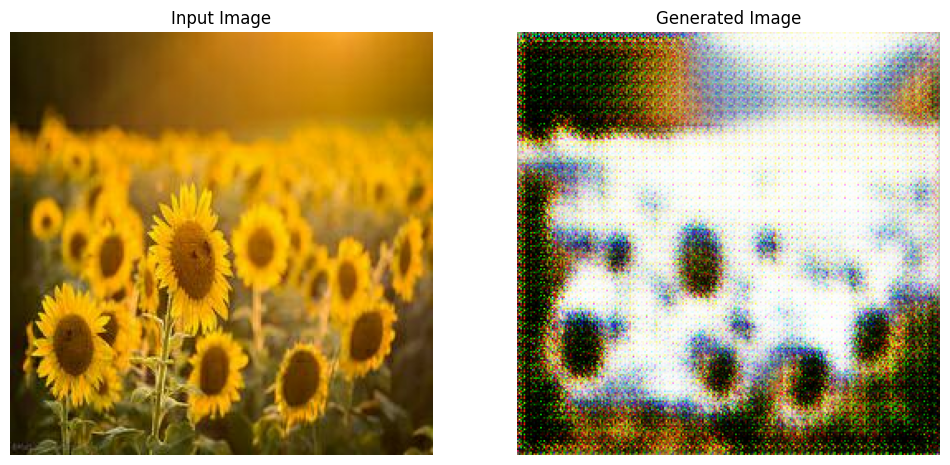

tf.Tensor([[-7.0460443]], shape=(1, 1), dtype=float32)


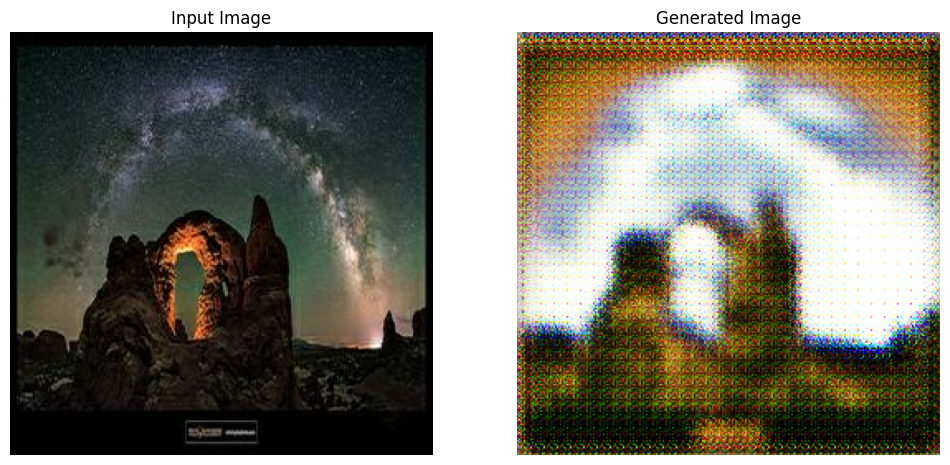

tf.Tensor([[-15.794491]], shape=(1, 1), dtype=float32)


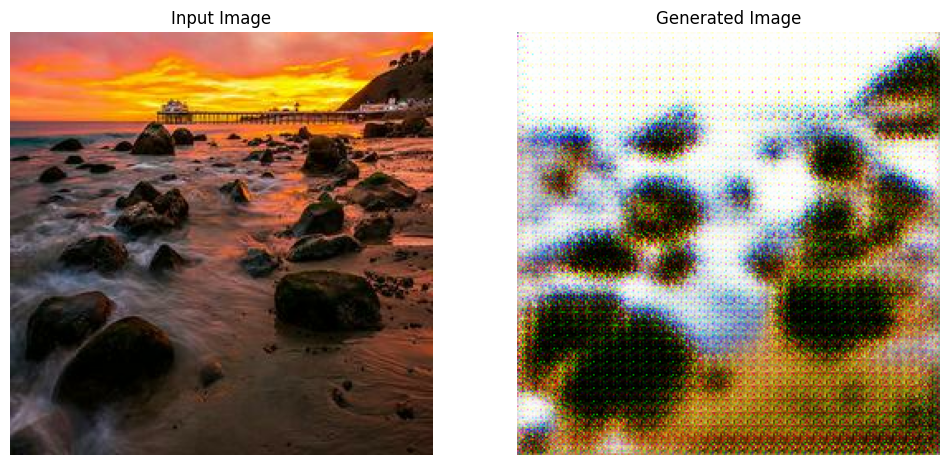

tf.Tensor([[5.557305]], shape=(1, 1), dtype=float32)


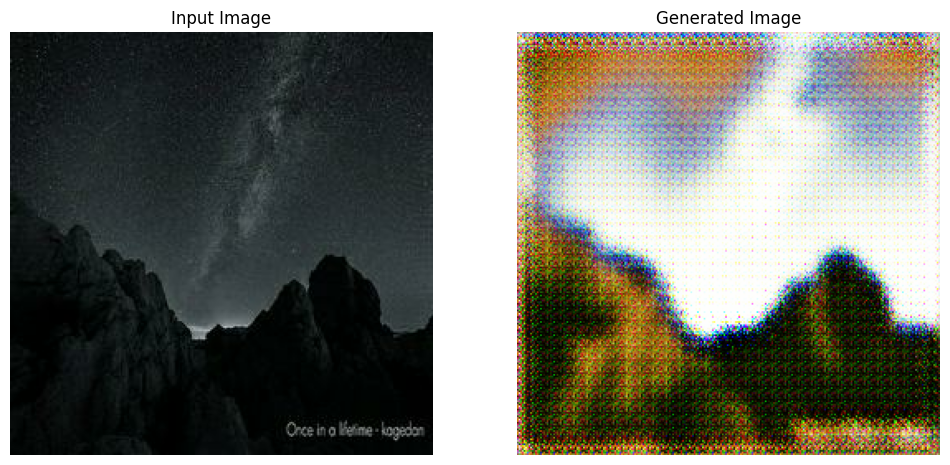

tf.Tensor([[-13.755567]], shape=(1, 1), dtype=float32)


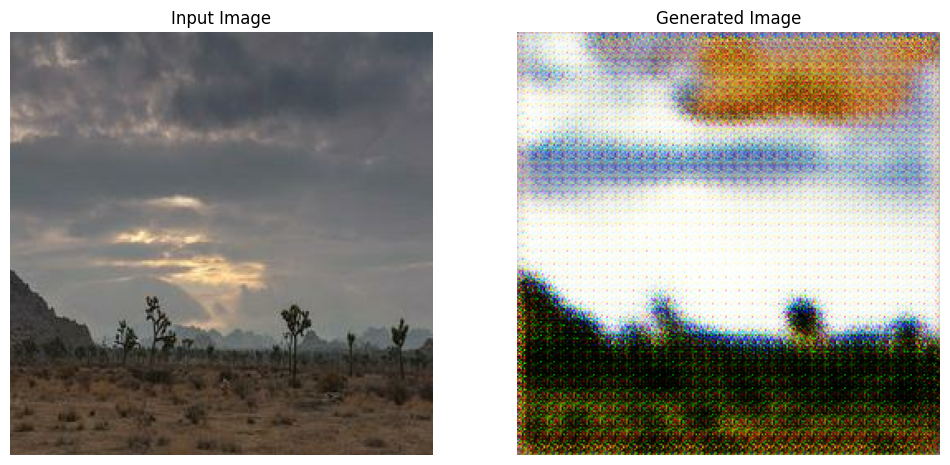

tf.Tensor([[-13.002515]], shape=(1, 1), dtype=float32)


In [36]:
# Generate Monet-style paintings for the sample photos
for _ in range(5):
    sample_real_image = next(iter(real_photos_dataset))

#     clear_output(wait=True)

    p = generate_images(loaded_generator, sample_real_image)
    print(loaded_discriminator(p))

In [37]:
# import os 
# len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))
# #creating a tmp file
# os.mkdir("../images")

In [38]:
# !ls ../images 

In [39]:
# import os 
# len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))
# #creating a tmp file
# os.mkdir("../images")
# import zipfile

# num_images_ = len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))

# # Define a function to generate and save images
# def generate_and_save_images(model, dataset, num_images):
#     # Generate Monet-style paintings for the specified number of images
#     for num in range(num_images):
#         # Get a batch of real images from the dataset
#         sample_real_images = next(iter(dataset))
#         # Generate Monet-style paintings for the batch of real images
#         generated_images = model(sample_real_images, training=True)
#         # Convert the pixel values to the range [0, 255] and cast to uint8
#         generated_images = (generated_images.numpy() * 127.5 + 127.5).astype(np.uint8)
#         # Save each generated image to the zip file
#         for i, image in enumerate(generated_images):
#             image_filename = f'../images/image_{num * num_images + i}.jpg'
#             # Write the image to the zip file
#             cv2.imwrite(image_filename, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
            
#         if num%500==0:
#             print(f'We have preprocessed {num} images')

# # Generate and save images
# generate_and_save_images(loaded_generator, real_photos_dataset,num_images_)


In [40]:
# import shutil


# shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

---

# Using the old Model as a pretrained 

## New Arch

In [41]:
from tensorflow.keras import layers, Model

def build_generator_new():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))

    down_stack = [
        layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.LeakyReLU(),
        layers.Conv2D(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2D(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),
        layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU()
    ]

    up_stack = [
        layers.Conv2DTranspose(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),
        layers.Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),
        layers.Conv2DTranspose(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),
        layers.Conv2DTranspose(32, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU()
    ]

    last = layers.Conv2DTranspose(3, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', activation='tanh')

    x = inputs
    for down in down_stack:
        x = down(x)
    for up in up_stack:
        x = up(x)
    outputs = last(x)

    return Model(inputs, outputs)


In [42]:
def build_discriminator_new():
    inputs = layers.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
    x = layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(inputs)

    x = layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(inputs)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU()(x)
    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)

    return Model(inputs, x)


In [43]:
# Load the saved generator model
existing_generator_g = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/generator_model_latest.h5')
existing_generator_f = tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/generator_model_inverse_latest.h5')

# Load the saved discriminator model
existing_discriminator_x = build_discriminator_new()#tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/discriminator_model_latest.h5')
existing_discriminator_y = build_discriminator_new()#tf.keras.models.load_model('/kaggle/input/cyclegan/keras/latest/1/discriminator_model_inverse_latest.h5')



In [44]:
# # Define the existing models
# existing_generator_g = generator_g
# existing_generator_f = generator_f
# existing_discriminator_x = discriminator_x
# existing_discriminator_y = discriminator_y

# Freeze the weights of the existing models
for model in [existing_generator_g, existing_generator_f]:
    for layer in model.layers:
        layer.trainable = False

In [45]:
# Freeze the weights of the existing models
for model in [existing_discriminator_x, existing_discriminator_y]:
    for layer in model.layers:
        layer.trainable = False

In [46]:
second_generator_g = build_generator_new()
second_generator_f = build_generator_new()

combined_generator_g = Model(existing_generator_g.input, [second_generator_g(existing_generator_g.output)])
combined_generator_f = Model(existing_generator_f.input, [second_generator_g(existing_generator_f.output)])

combined_generator_g, combined_generator_f

(<Functional name=functional_21, built=True>,
 <Functional name=functional_23, built=True>)

## Training the new model

##### Addding some augmentation

In [47]:
import tensorflow as tf

IMG_SIZE = 256  # Adjust based on your dataset's image size

def preprocess_image(image):
    image = tf.image.resize(image, [IMG_SIZE, IMG_SIZE])
    image = (image / 127.5) - 1
    return image
def sharpen_image(image):
    kernel = tf.constant([[0, -1, 0], [-1, 5, -1], [0, -1, 0]], dtype=tf.float32)
    kernel = tf.reshape(kernel, [3, 3, 1, 1])
    image = tf.expand_dims(image, axis=0)  # Add batch dimension
    image = tf.nn.conv2d(image, kernel, strides=[1, 1, 1, 1], padding='SAME')
    image = tf.squeeze(image, axis=0)  # Remove batch dimension
    return image
def augment(image):
#     image = tf.image.random_flip_left_right(image)
#     image = tf.image.random_flip_up_down(image)
    
    image = tf.image.random_brightness(image, max_delta=0.2)
#     image = tf.image.random_contrast(image, 0.8, 1.2)
#     image = tf.image.random_saturation(image, 0.8, 1.2)
#     image = sharpen_image(image)
    return image

def load_and_preprocess_image(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = preprocess_image(image)
    shape = image.shape
    image = augment(image).reshape(shape)
    return image


Restored from ./checkpoints_combined/ckpt-16
..............................Time for epoch 1 is 46.5560507774353 sec


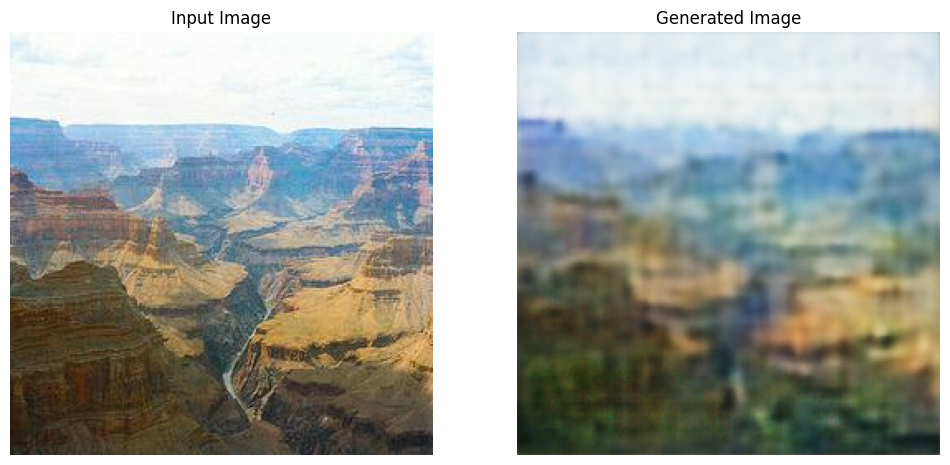

..............................Time for epoch 2 is 27.78112030029297 sec


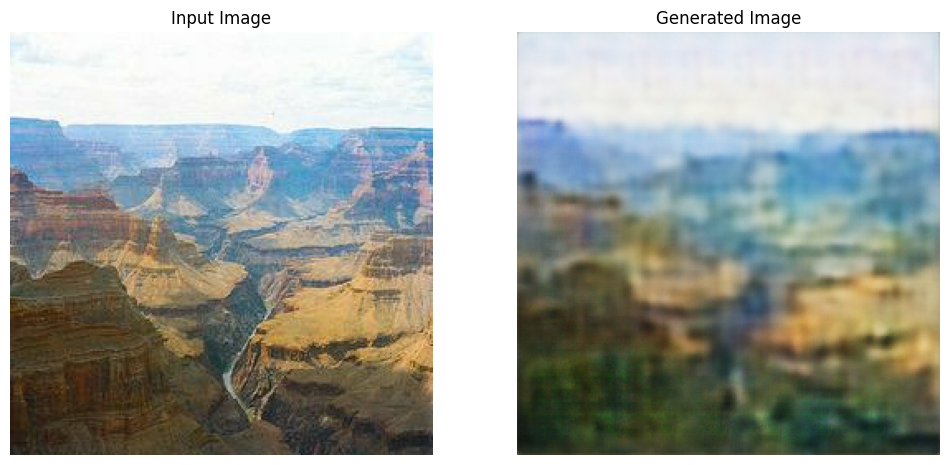

..............................Time for epoch 3 is 27.83054494857788 sec


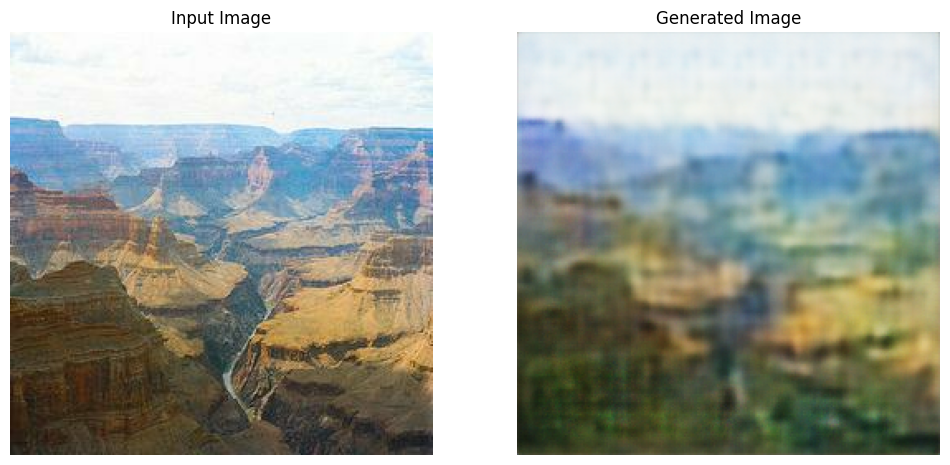

..............................Time for epoch 4 is 27.729278802871704 sec


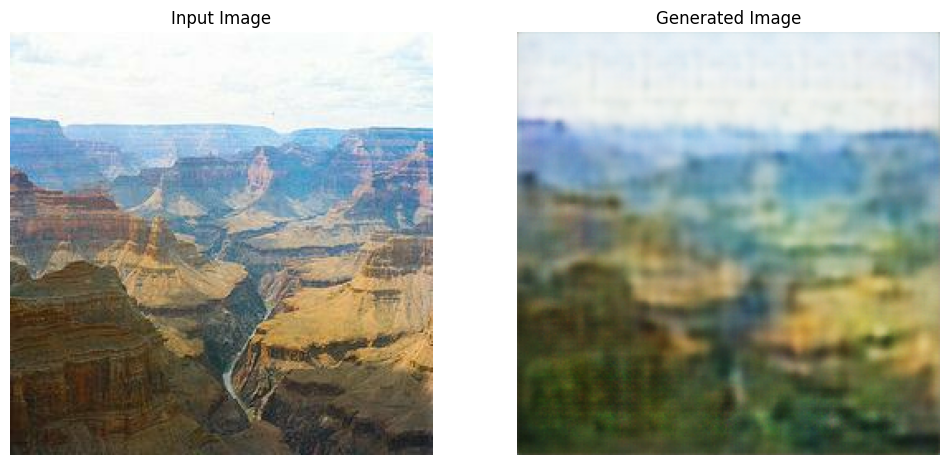

..............................Time for epoch 5 is 27.7419753074646 sec


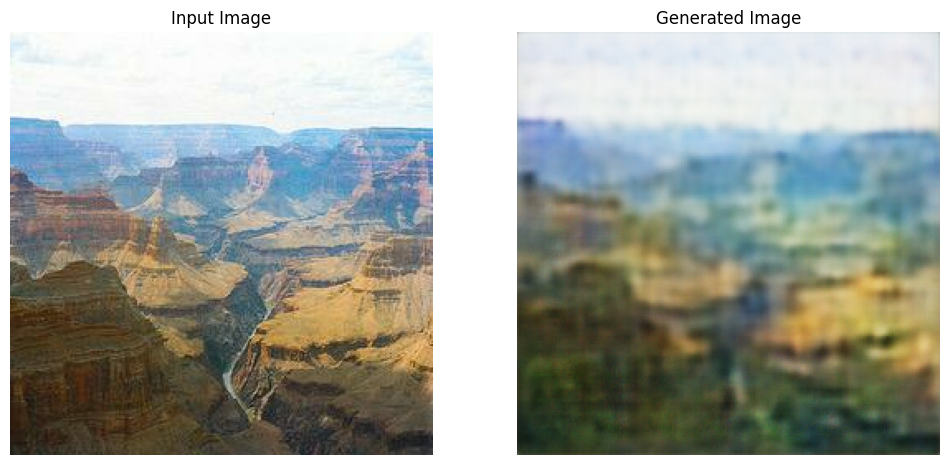

..............................Time for epoch 6 is 27.725886344909668 sec


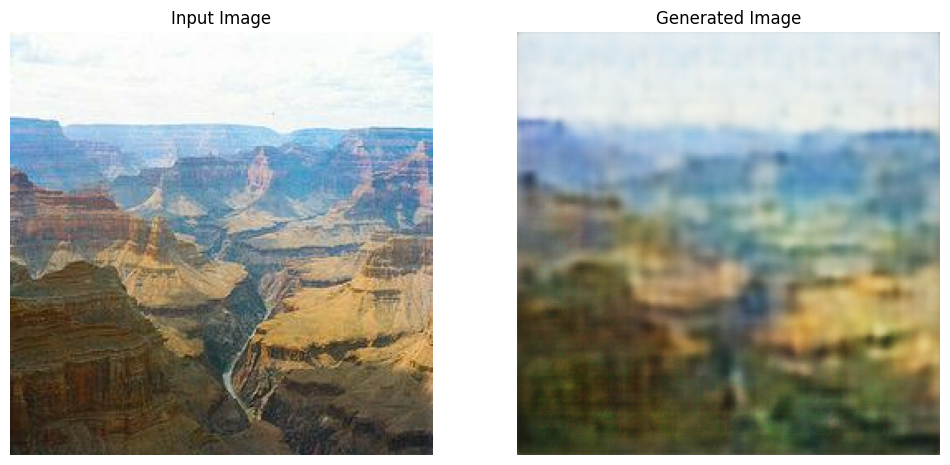

..............................Time for epoch 7 is 27.68379783630371 sec


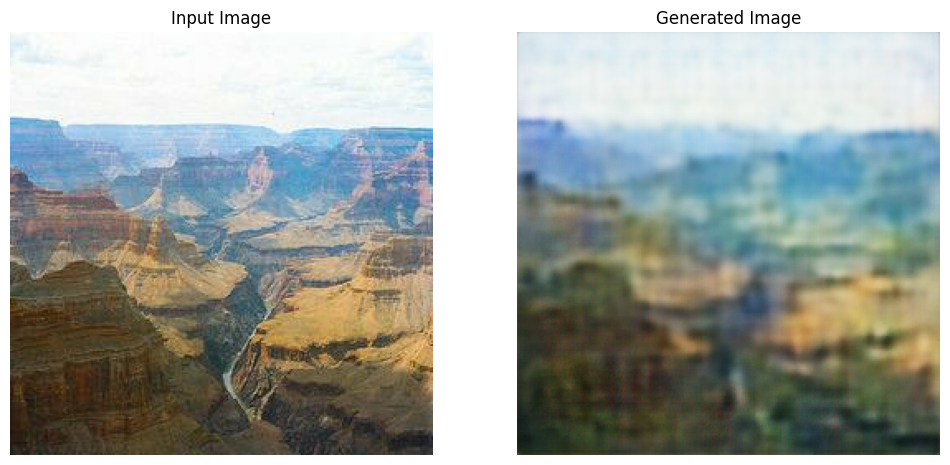

..............................Time for epoch 8 is 27.797242641448975 sec


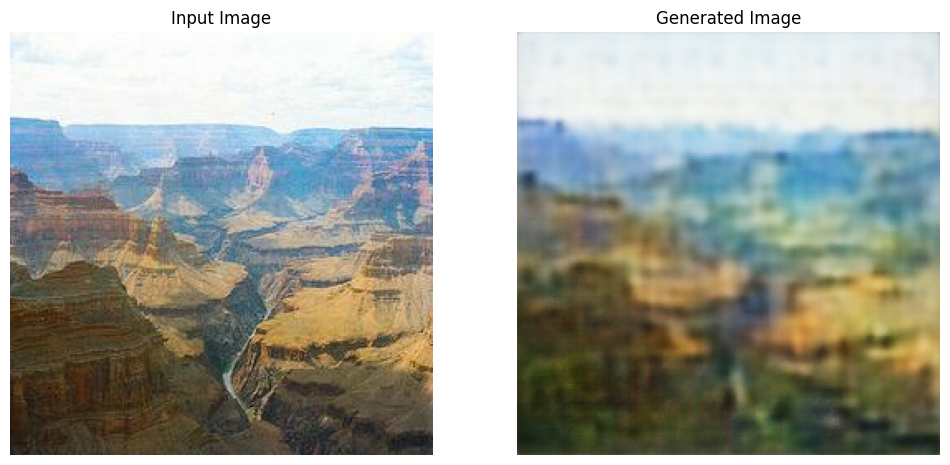

..............................Time for epoch 9 is 27.765240907669067 sec


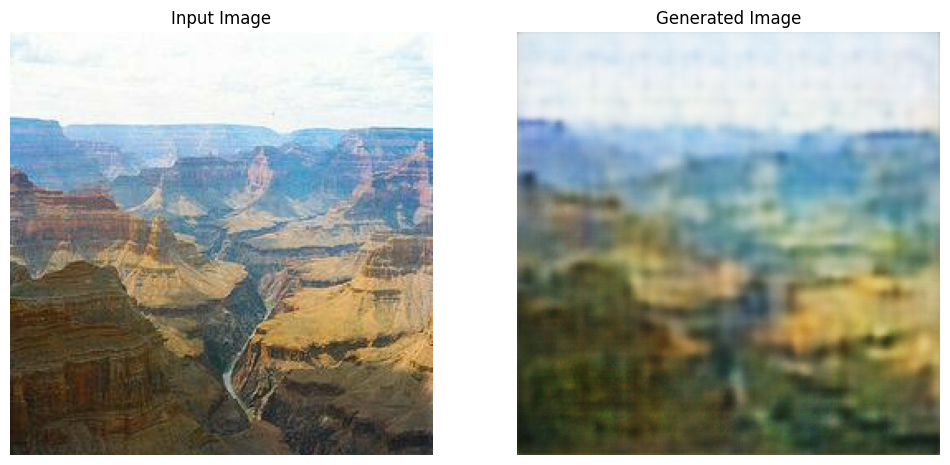

..............................Time for epoch 10 is 27.758450746536255 sec


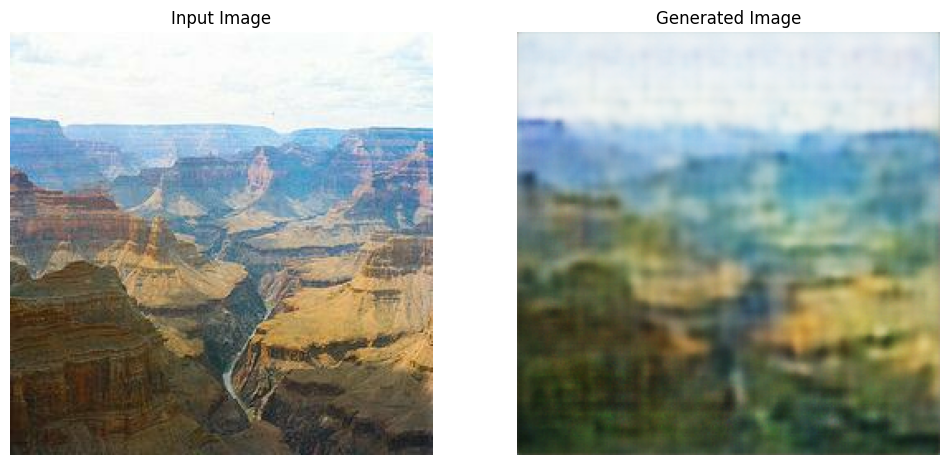

..............................Time for epoch 11 is 27.735843420028687 sec


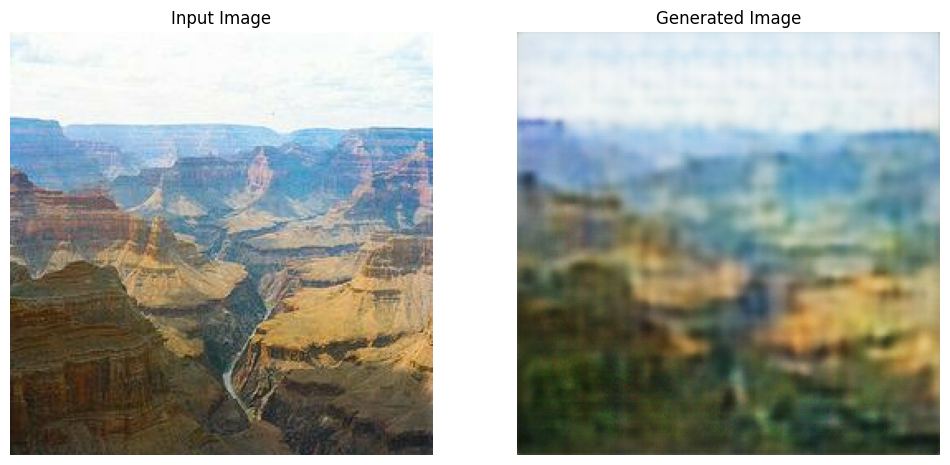

..............................Time for epoch 12 is 27.78628706932068 sec


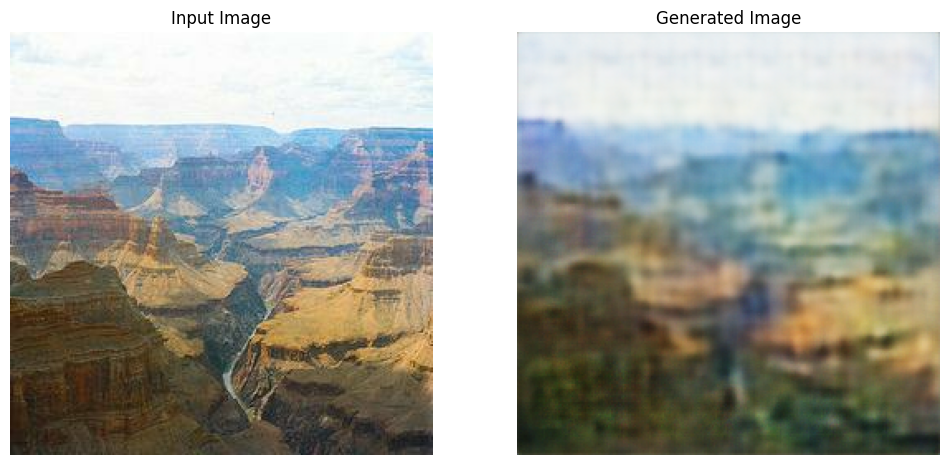

..............................Time for epoch 13 is 27.89400005340576 sec


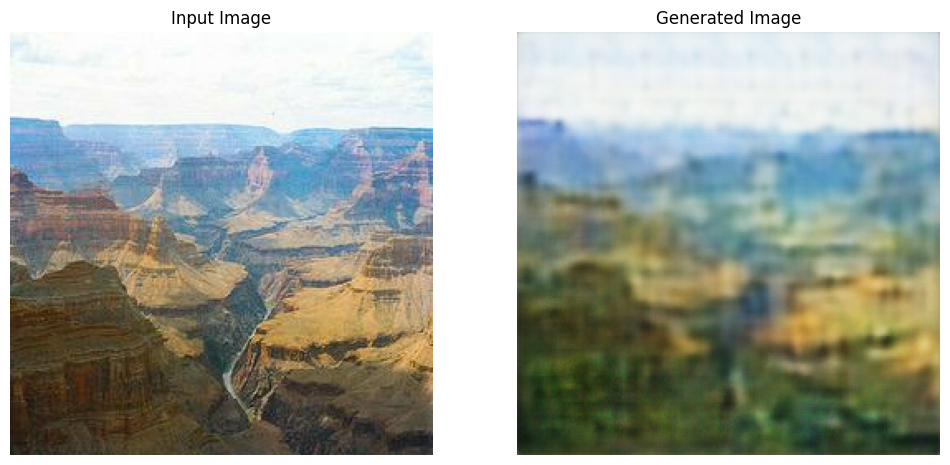

..............................Time for epoch 14 is 27.917401552200317 sec


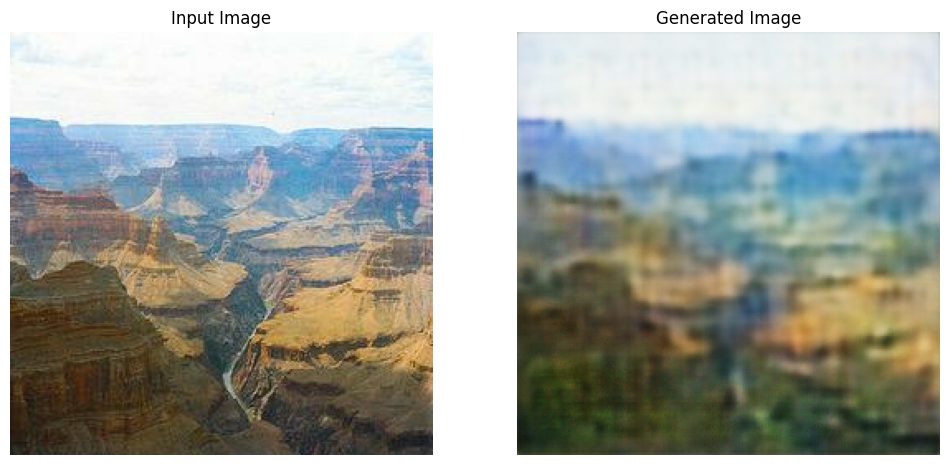

........................

KeyboardInterrupt: 

In [48]:
from IPython.display import clear_output

# Loss function for both generator and discriminator
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Discriminator loss
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

# Generator loss
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Cycle consistency loss
def calc_cycle_loss(real_image, cycled_image):
    loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return loss

# Identity loss
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return loss

# Optimizers
generator_g_optimizer = tf.keras.optimizers.Adam(2e-6, beta_1=0.9)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-6, beta_1=0.9)
discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-7, beta_1=0.9)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-7, beta_1=0.9)

steping_noise = 0
@tf.function
def train_step(real_x, real_y):
    # +Augmentation
#     global steping_noise
#     steping_noise =+ 1
#     if steping_noise<3:
#         print(steping_noise)
        
# #     real_x = augment(preprocess_image(real_x))
# #     real_y = augment(preprocess_image(real_y))
#         # Adding noise progressively
#     def get_noise_schedule(epoch, initial_noise, final_noise):
#         return initial_noise + (final_noise - initial_noise) * (1/epoch)

#     noise = get_noise_schedule(steping_noise, initial_noise=0.1, final_noise=0.01)

#     # Add noise to real images
#     real_x_noised = real_x + noise * tf.random.normal(real_x.shape)
#     real_y_noised = real_y + noise * tf.random.normal(real_y.shape)
    
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        fake_y = combined_generator_g(real_x, training=True)#real_x
        cycled_x = combined_generator_f(fake_y, training=True)#

        # Generator F translates Y -> X
        fake_x = combined_generator_f(real_y, training=True)#real_y
        cycled_y = combined_generator_g(fake_x, training=True)

        # Same images to identity loss
        same_x = combined_generator_f(real_x, training=True)
        same_y = combined_generator_g(real_y, training=True)

        # Discriminator outputs
        disc_real_x = existing_discriminator_x(real_x, training=True)
        disc_real_y = existing_discriminator_y(real_y, training=True)
        
        disc_fake_x = existing_discriminator_x(fake_x, training=True)
        disc_fake_y = existing_discriminator_y(fake_y, training=True)

        # Generator adversarial loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        # Cycle consistency loss
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Total generator loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Discriminator loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate the gradients
    generator_g_gradients = tape.gradient(total_gen_g_loss, combined_generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, combined_generator_f.trainable_variables)
#     discriminator_x_gradients = tape.gradient(disc_x_loss, existing_discriminator_x.trainable_variables)
#     discriminator_y_gradients = tape.gradient(disc_y_loss, existing_discriminator_y.trainable_variables)

    # Apply the gradients
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, combined_generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, combined_generator_f.trainable_variables))
#     discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, existing_discriminator_x.trainable_variables))
#     discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, existing_discriminator_y.trainable_variables))

checkpoint_dir = './checkpoints_combined'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_g=combined_generator_g,
                                 generator_f=combined_generator_f,
                                 discriminator_x=existing_discriminator_x,
                                 discriminator_y=existing_discriminator_y,
                                 generator_g_optimizer=generator_g_optimizer,
                                 generator_f_optimizer=generator_f_optimizer,
                                 discriminator_x_optimizer=discriminator_x_optimizer,
                                 discriminator_y_optimizer=discriminator_y_optimizer)

# Training function
import time
def generate_images(model, test_input):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Generated Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')
    plt.show()

def train(real_dataset, monet_dataset, epochs):
    for epoch in range(epochs):
        start = time.time()

        n = 0
        for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)):
            train_step(real_x, real_y)
            if n % 10 == 0:
                print('.', end='', flush=True)
            n += 1

        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

        # Produce images for the GIF as we go
#         clear_output(wait=True)
        generate_images(combined_generator_g, sample_real_image)
        # Save the model every 5 epochs
        if (epoch + 1) % 20 == 0:
            print('checkpoint_prefix')
            checkpoint.save(file_prefix=checkpoint_prefix)

# Sample images
sample_real_image = next(iter(real_photos_dataset))


# Restore the latest checkpoint
latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
if latest_checkpoint:
    checkpoint.restore(latest_checkpoint)
    print(f'Restored from {latest_checkpoint}')
else:
    print('Starting training from 14-check.')
    checkpoint.restore('/kaggle/input/cyclegan/keras/checkpoint/3/ckpt-14')



# Train the CycleGAN
EPOCHS = 100
train(real_photos_dataset, monet_paintings_dataset, EPOCHS)


In [49]:
# Restore the latest checkpoint
latest_checkpoint = '/kaggle/input/cyclegan/keras/checkpoint/3/ckpt-14'#tf.train.latest_checkpoint(checkpoint_dir)
if latest_checkpoint:
    checkpoint.restore(latest_checkpoint)
    print(f'Restored from {latest_checkpoint}')
else:
    print('Starting training from scratch.')

Restored from /kaggle/input/cyclegan/keras/checkpoint/3/ckpt-14


### Visualize

In [50]:
def generate_images(model, test_input):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Generated Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')
    plt.show()
    return  prediction 

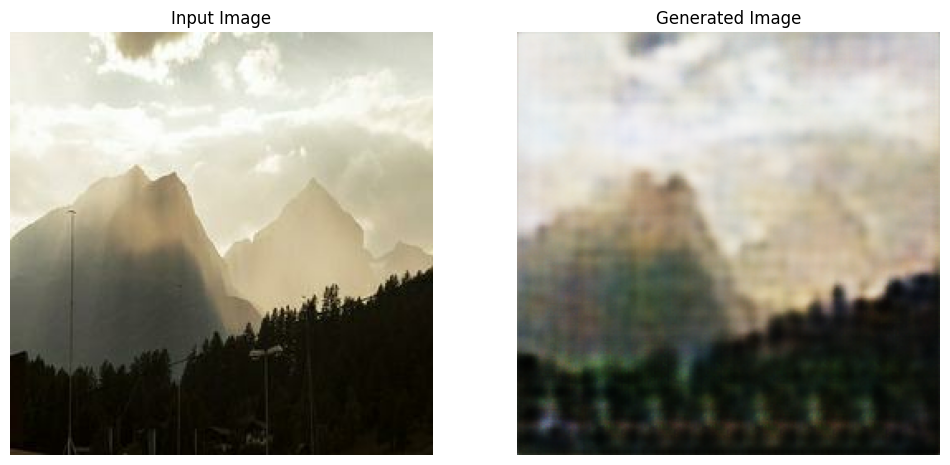

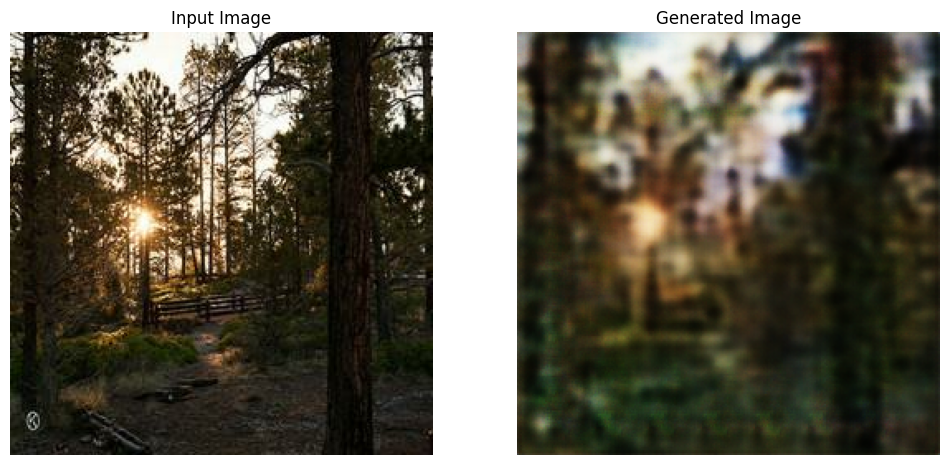

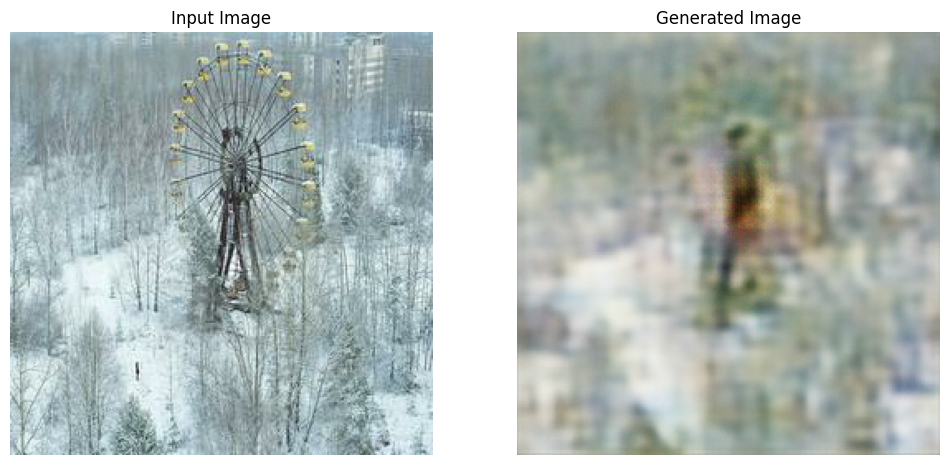

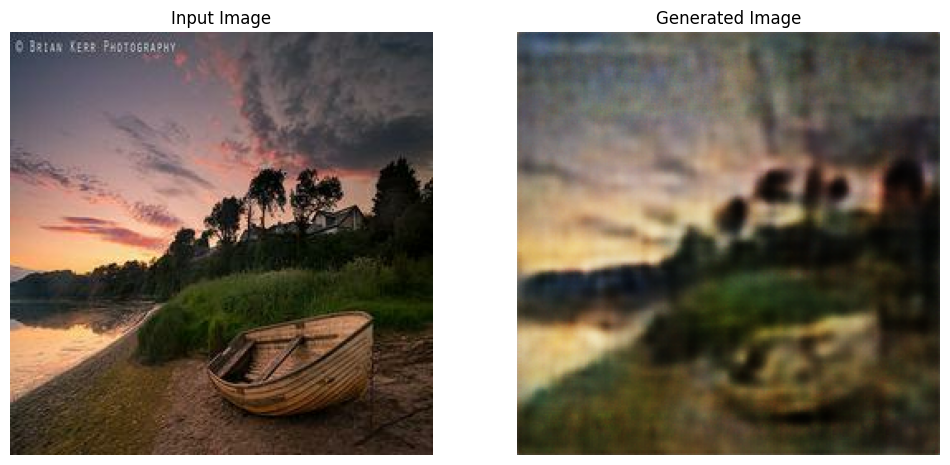

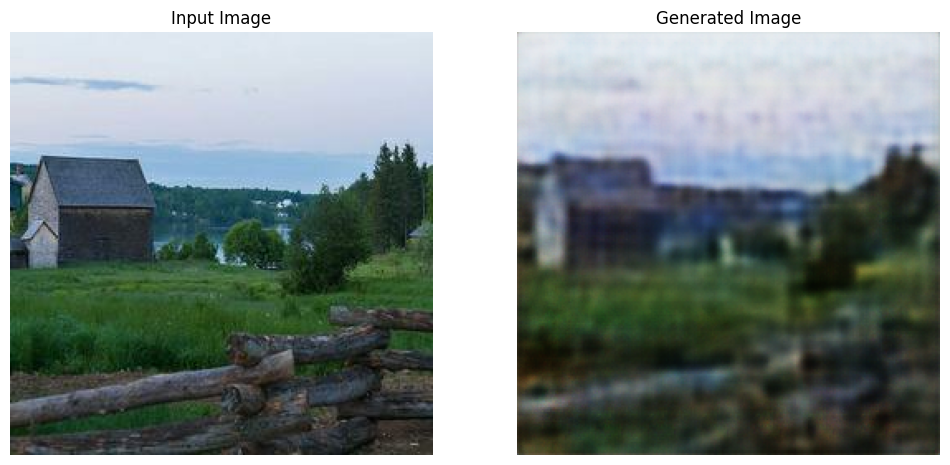

In [51]:
# Generate Monet-style paintings for the sample photos
for _ in range(5):
    sample_real_image = next(iter(real_photos_dataset))

#     clear_output(wait=True)

    p = generate_images(combined_generator_g, sample_real_image)
#     generate_images(combined_generator_f, p)

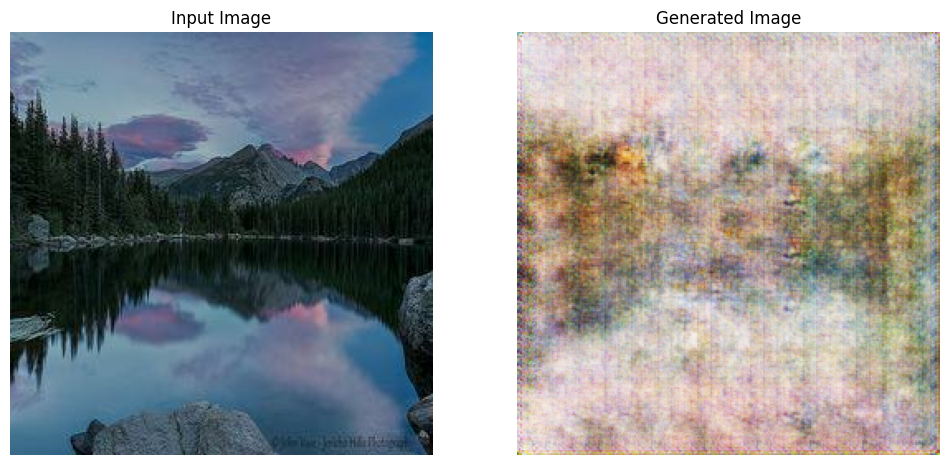

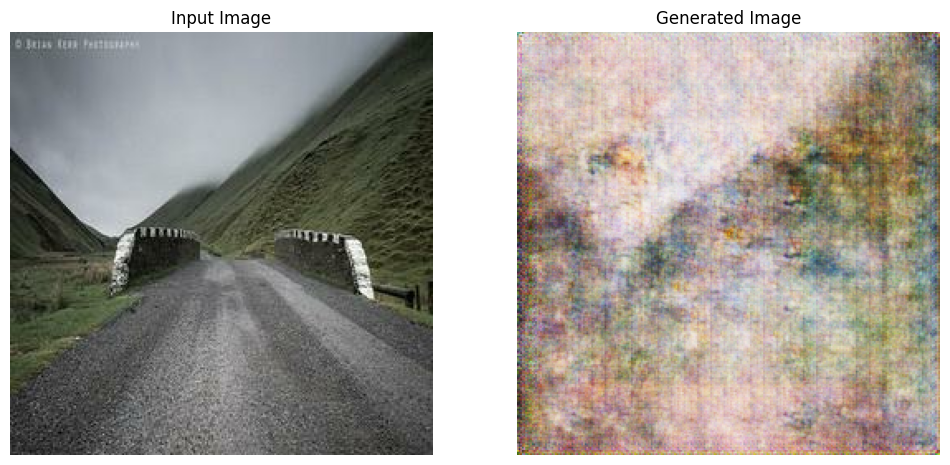

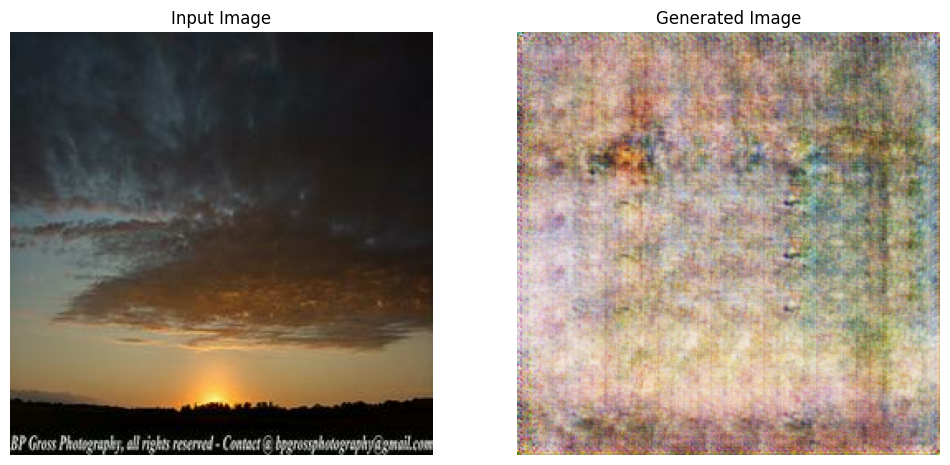

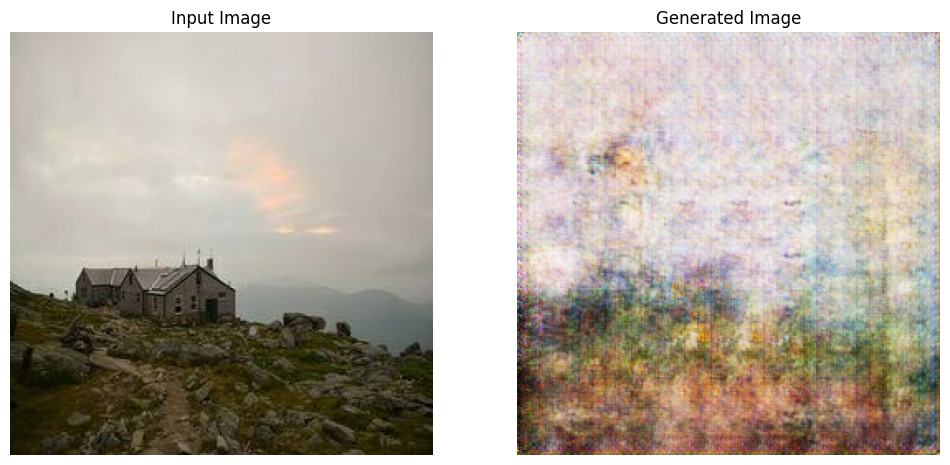

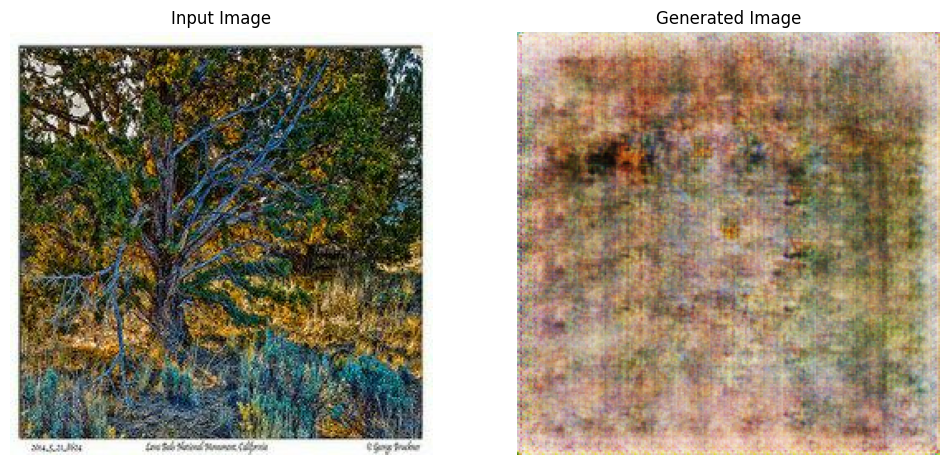

In [30]:
# Generate Monet-style paintings for the sample photos
for _ in range(5):
    sample_real_image = next(iter(real_photos_dataset))

#     clear_output(wait=True)

    p = generate_images(combined_generator_g, sample_real_image)

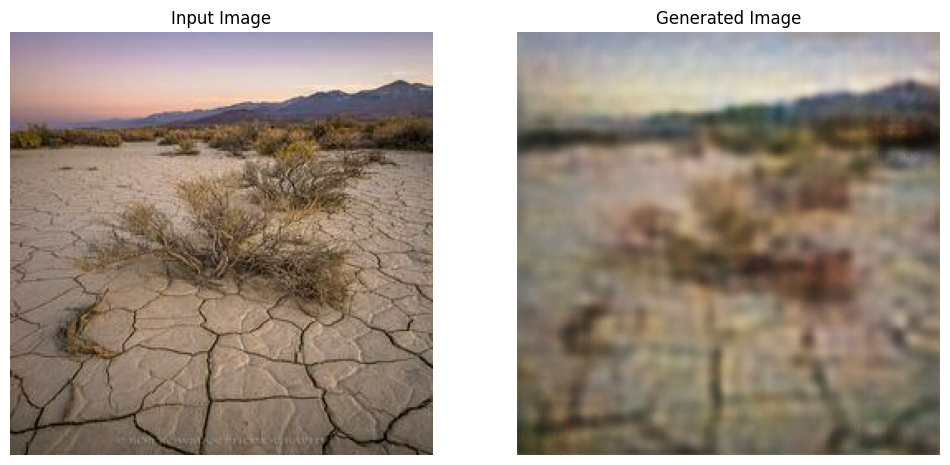

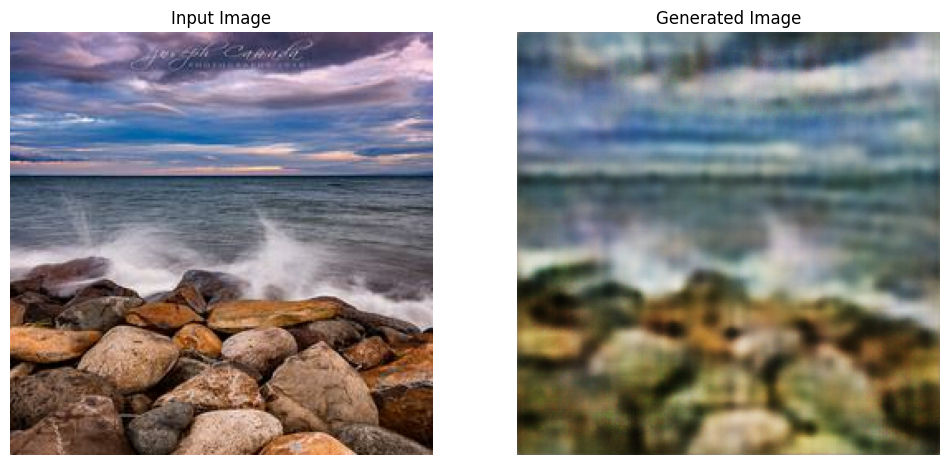

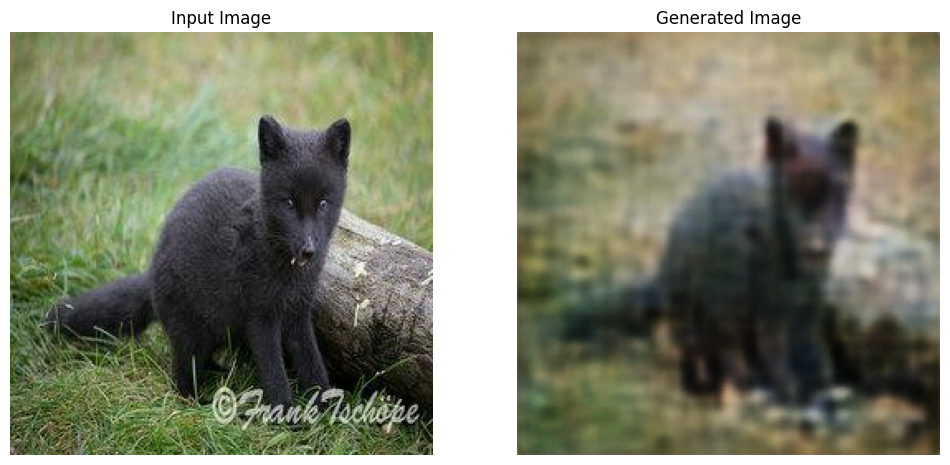

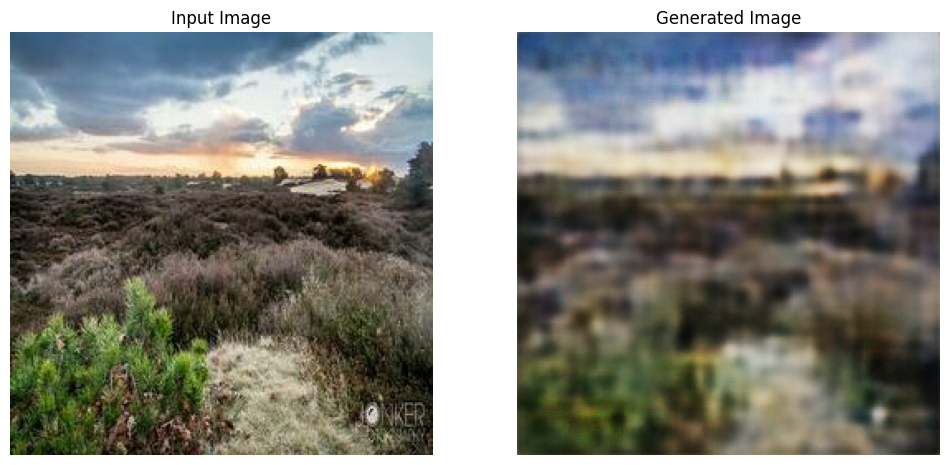

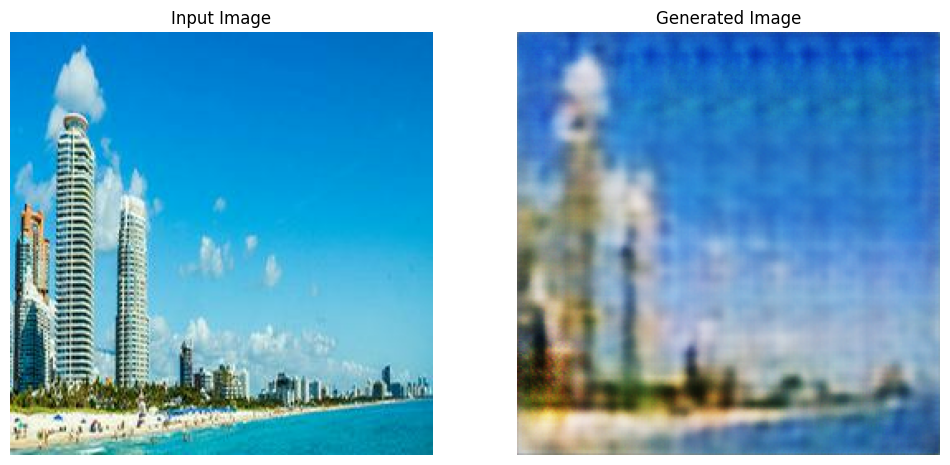

In [32]:
# Generate Monet-style paintings for the sample photos
for _ in range(5):
    sample_real_image = next(iter(real_photos_dataset))

#     clear_output(wait=True)

    p = generate_images(combined_generator_g, sample_real_image)

In [28]:
# import os 
# len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))
# #creating a tmp file
# os.mkdir("../images")
# import zipfile

# num_images_ = len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))

# # Define a function to generate and save images
# def generate_and_save_images(gen_g, gen_f, dataset, num_images):
#     # Generate Monet-style paintings for the specified number of images
#     for num in range(num_images):
#         # Get a batch of real images from the dataset
#         sample_real_images = next(iter(dataset))
#         # Generate Monet-style paintings for the batch of real images
#         generated_images = gen_g(sample_real_images, training=True)
#         generated_images = gen_f(generated_images, training=True)
        
#         # Convert the pixel values to the range [0, 255] and cast to uint8
#         generated_images = (generated_images.numpy() * 127.5 + 127.5).astype(np.uint8)
#         # Save each generated image to the zip file
#         for i, image in enumerate(generated_images):
#             image_filename = f'../images/image_{num * num_images + i}.jpg'
#             # Write the image to the zip file
#             cv2.imwrite(image_filename, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
            
#         if num%500==0:
#             print(f'We have preprocessed {num} images')

# # Generate and save images
# generate_and_save_images(combined_generator_g, combined_generator_f, real_photos_dataset,num_images_)

We have preprocessed 0 images


KeyboardInterrupt: 

In [29]:
# import shutil


# shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

'/kaggle/working/images.zip'

# Second combination

## Deeper Generator for finer details

In [23]:
from tensorflow.keras import layers, Model

def residual_block(x, filters, kernel_size=3):
    res = layers.Conv2D(filters, kernel_size, padding='same', kernel_initializer='he_normal', use_bias=False)(x)
    res = layers.BatchNormalization()(res)
    res = layers.ReLU()(res)
    res = layers.Conv2D(filters, kernel_size, padding='same', kernel_initializer='he_normal', use_bias=False)(res)
    res = layers.BatchNormalization()(res)
    return layers.add([x, res])

def build_deeper_generator(generator_kind='g'):
    if generator_kind=='g':
        inputs = layers.Input(shape=(256, 256, 3))
#     else:
#         # generator_f
#         inputs = layers.Input(shape=(512, 512, 3))

    # Downsampling layers
    down1 = layers.Conv2D(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(inputs)
    down1 = layers.LeakyReLU()(down1)
    
    down2 = layers.Conv2D(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(down1)
    down2 = layers.BatchNormalization()(down2)
    down2 = layers.LeakyReLU()(down2)
    
    down3 = layers.Conv2D(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(down2)
    down3 = layers.BatchNormalization()(down3)
    down3 = layers.LeakyReLU()(down3)
    
    down4 = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(down3)
    down4 = layers.BatchNormalization()(down4)
    down4 = layers.LeakyReLU()(down4)
    
    down5 = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(down4)
    down5 = layers.BatchNormalization()(down5)
    down5 = layers.LeakyReLU()(down5)
    
    down6 = layers.Conv2D(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(down5)
    down6 = layers.BatchNormalization()(down6)
    down6 = layers.LeakyReLU()(down6)

    # Bottleneck layers with residual blocks
    bottleneck = residual_block(down6, 512)
    bottleneck = residual_block(bottleneck, 512)
    bottleneck = residual_block(bottleneck, 512)
    bottleneck = residual_block(bottleneck, 512)

    # Upsampling layers
    up1 = layers.Conv2DTranspose(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(bottleneck)
    up1 = layers.BatchNormalization()(up1)
    up1 = layers.ReLU()(up1)
    
    up2 = layers.Conv2DTranspose(512, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(up1)
    up2 = layers.BatchNormalization()(up2)
    up2 = layers.ReLU()(up2)
    
    up3 = layers.Conv2DTranspose(256, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(up2)
    up3 = layers.BatchNormalization()(up3)
    up3 = layers.ReLU()(up3)
    
    up4 = layers.Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(up3)
    up4 = layers.BatchNormalization()(up4)
    up4 = layers.ReLU()(up4)
    
    up5 = layers.Conv2DTranspose(64, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(up4)
    up5 = layers.BatchNormalization()(up5)
    up5 = layers.ReLU()(up5)

#     up6 = layers.Conv2DTranspose(32, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', use_bias=False)(up5)
#     up6 = layers.BatchNormalization()(up6)
#     up6 = layers.ReLU()(up6)

    outputs = layers.Conv2DTranspose(3, (4, 4), strides=2, padding='same', kernel_initializer='he_normal', activation='tanh')(up5)

    return Model(inputs, outputs)

# Build the deeper generator model
deeper_generator = build_deeper_generator()
deeper_generator.summary()


Model: "functional_23"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_64 (Conv2D)  │ (None, 128, 128,  │      3,072 │ input_layer_7[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_38      │ (None, 128, 128,  │          0 │ conv2d_64[0][0]   │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_65 (Conv2D)  │ (None, 64, 64,    │    131,072 │ leaky_re_lu_38[0… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_65[0][0]   │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_39      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_66 (Conv2D)  │ (None, 32, 32,    │    524,288 │ leaky_re_lu_39[0… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 32,    │      1,024 │ conv2d_66[0][0]   │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_40      │ (None, 32, 32,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_67 (Conv2D)  │ (None, 16, 16,    │  2,097,152 │ leaky_re_lu_40[0… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 16,    │      2,048 │ conv2d_67[0][0]   │
│ (BatchNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_41      │ (None, 16, 16,    │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_68 (Conv2D)  │ (None, 8, 8, 512) │  4,194,304 │ leaky_re_lu_41[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 8, 8, 512) │      2,048 │ conv2d_68[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_42      │ (None, 8, 8, 512) │          0 │ batch_normalizat… │
│ (LeakyReLU)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_69 (Conv2D)  │ (None, 4, 4, 512) │  4,194,304 │ leaky_re_lu_42[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 4, 4, 512) │      2,048 │ conv2d_69[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 41,192,707 (157.14 MB)

 Trainable params: 41,177,731 (157.08 MB)

 Non-trainable params: 14,976 (58.50 KB)

deep_generator_g = build_deeper_generator()
deep_generator_f = build_deeper_generator()

deep_combined_generator_g = Model(combined_generator_g.input, [deep_generator_g(combined_generator_g.output)])
deep_combined_generator_f = Model(combined_generator_f.input, [deep_generator_g(combined_generator_f.output)])

deep_combined_generator_g, deep_combined_generator_f

# Freeze the weights of the existing models
for model in [combined_generator_g, combined_generator_f]:
    for layer in model.layers:
        layer.trainable = False

deep_discriminator_x = existing_discriminator_x
deep_discriminator_y = existing_discriminator_y

# Freeze the weights of the existing models
for model in [deep_discriminator_y, deep_discriminator_x]:
    for layer in model.layers:
        layer.trainable = False

# Training the Fully combined model

from IPython.display import clear_output

# Loss function for both generator and discriminator
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# Discriminator loss
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

# Generator loss
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# Cycle consistency loss
def calc_cycle_loss(real_image, cycled_image):
    loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return loss

# Identity loss
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image - same_image))
    return loss

# Optimizers
generator_g_optimizer = tf.keras.optimizers.Adam(2e-2, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-2, beta_1=0.5)
# discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-6, beta_1=0.5)
# discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-6, beta_1=0.5)

steping_noise = 0
@tf.function
def train_step(real_x, real_y):
#     # +Augmentation
#     global steping_noise
#     steping_noise =+ 1
#     if steping_noise<3:
#         print(steping_noise)
        
# #     real_x = augment(preprocess_image(real_x))
# #     real_y = augment(preprocess_image(real_y))
#         # Adding noise progressively
#     def get_noise_schedule(epoch, initial_noise, final_noise):
#         return initial_noise + (final_noise - initial_noise) * (1/epoch)

#     noise = get_noise_schedule(steping_noise, initial_noise=0.1, final_noise=0.01)

#     # Add noise to real images
#     real_x_noised = real_x + noise * tf.random.normal(real_x.shape)
#     real_y_noised = real_y + noise * tf.random.normal(real_y.shape)
    
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        fake_y = deep_combined_generator_g(real_x, training=True)#real_x
        cycled_x = deep_combined_generator_f(fake_y, training=True)#

        # Generator F translates Y -> X
        fake_x = deep_combined_generator_f(real_y, training=True)#real_y
        cycled_y = deep_combined_generator_g(fake_x, training=True)

        # Same images to identity loss
        same_x = deep_combined_generator_f(real_x, training=True)
        same_y = deep_combined_generator_g(real_y, training=True)

        # Discriminator outputs
        disc_real_x = deep_discriminator_x(real_x, training=True)
        disc_real_y = deep_discriminator_y(real_y, training=True)
        disc_fake_x = deep_discriminator_x(fake_x, training=True)
        disc_fake_y = deep_discriminator_y(fake_y, training=True)

        # Generator adversarial loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        # Cycle consistency loss
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Total generator loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Discriminator loss
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    # Calculate the gradients
    generator_g_gradients = tape.gradient(total_gen_g_loss, deep_combined_generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, deep_combined_generator_f.trainable_variables)
#     discriminator_x_gradients = tape.gradient(disc_x_loss, deep_discriminator_x.trainable_variables)
#     discriminator_y_gradients = tape.gradient(disc_y_loss, deep_discriminator_y.trainable_variables)

    # Apply the gradients
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, deep_combined_generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, deep_combined_generator_f.trainable_variables))
#     discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, deep_discriminator_x.trainable_variables))
#     discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, deep_discriminator_y.trainable_variables))

checkpoint_dir = './checkpoints_combined_deep'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_g=deep_combined_generator_g,
                                 generator_f=deep_combined_generator_f,
                                 discriminator_x=deep_discriminator_x,
                                 discriminator_y=deep_discriminator_y,
                                 generator_g_optimizer=generator_g_optimizer,
                                 generator_f_optimizer=generator_f_optimizer,
                                 discriminator_x_optimizer=discriminator_x_optimizer,
                                 discriminator_y_optimizer=discriminator_y_optimizer)

# Training function
import time
def generate_images(model, test_input):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Generated Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')
    plt.show()

def train(real_dataset, monet_dataset, epochs):
    for epoch in range(epochs):
        start = time.time()

        n = 0
        for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)):
            train_step(real_x, real_y)
            if n % 10 == 0:
                print('.', end='', flush=True)
            n += 1

        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

        # Produce images for the GIF as we go
#         clear_output(wait=True)
        generate_images(deep_combined_generator_g, sample_real_image)
        # Save the model every 5 epochs
        if (epoch + 1) % 20 == 0:
            print('checkpoint_prefix')
            checkpoint.save(file_prefix=checkpoint_prefix)

# Sample images
sample_real_image = next(iter(real_photos_dataset))


# Restore the latest checkpoint
latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
if latest_checkpoint:
    checkpoint.restore(latest_checkpoint)
    print(f'Restored from {latest_checkpoint}')
else:
    print('Starting training from scratch.')
# checkpoint.restore('/kaggle/input/cyclegan/keras/checkpoint/3/ckpt-14')


# Train the CycleGAN
EPOCHS = 200
train(real_photos_dataset, monet_paintings_dataset, EPOCHS)


import os 
len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))
#creating a tmp file
os.mkdir("../images")
import zipfile

num_images_ = len(os.listdir('/kaggle/input/gan-getting-started/photo_jpg'))

# Define a function to generate and save images
def generate_and_save_images(gen_g, gen_f, dataset, num_images):
    # Generate Monet-style paintings for the specified number of images
    for num in range(num_images):
        # Get a batch of real images from the dataset
        sample_real_images = next(iter(dataset))
        # Generate Monet-style paintings for the batch of real images
        generated_images = gen_g(sample_real_images, training=True)
        generated_images = gen_f(generated_images, training=True)
        
        # Convert the pixel values to the range [0, 255] and cast to uint8
        generated_images = (generated_images.numpy() * 127.5 + 127.5).astype(np.uint8)
        # Save each generated image to the zip file
        for i, image in enumerate(generated_images):
            image_filename = f'../images/image_{num * num_images + i}.jpg'
            # Write the image to the zip file
            cv2.imwrite(image_filename, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))
            
        if num%500==0:
            print(f'We have preprocessed {num} images')

# Generate and save images
generate_and_save_images(deep_combined_generator_g, deep_combined_generator_f, real_photos_dataset,num_images_)

import shutil


shutil.make_archive("/kaggle/working/images", 'zip', "/kaggle/images")

# Including The MIFID loss/metric

In [ ]:
# import os
# import zipfile
# import numpy as np
# import cv2
# import tensorflow as tf
# import matplotlib.pyplot as plt
# from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
# from scipy.linalg import sqrtm
# from sklearn.metrics.pairwise import cosine_distances
# from tqdm import tqdm
# from PIL import Image
# from IPython.display import clear_output

# # Model Parameters
# model_params = {
#     'Inception': {
#         'name': 'Inception',
#         'imsize': 256,
#         'output_layer': 'mixed10',
#         'input_layer': 'input_1',
#         'output_shape': 2048,
#         'cosine_distance_eps': 0.1
#     }
# }

# # Load the InceptionV3 model for feature extraction
# inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(256, 256, 3))

# # Define MiFID calculation functions
# def calculate_fid(real_images, generated_images):
#     real_images_resized = tf.image.resize(real_images, (256, 256))
#     generated_images_resized = tf.image.resize(generated_images, (256, 256))

#     real_images_preprocessed = preprocess_input(real_images_resized.numpy())
#     generated_images_preprocessed = preprocess_input(generated_images_resized.numpy())

#     real_features = inception_model.predict(real_images_preprocessed)
#     generated_features = inception_model.predict(generated_images_preprocessed)

#     mu_real, sigma_real = np.mean(real_features, axis=0), np.cov(real_features, rowvar=False)
#     mu_generated, sigma_generated = np.mean(generated_features, axis=0), np.cov(generated_features, rowvar=False)

#     diff = mu_real - mu_generated
#     covmean, _ = sqrtm(sigma_real.dot(sigma_generated), disp=False)
#     if np.iscomplexobj(covmean):
#         covmean = covmean.real

#     fid = np.sum(diff**2) + np.trace(sigma_real + sigma_generated - 2 * covmean)
#     return fid

# def calculate_mifid(real_images, generated_images):
#     fid = calculate_fid(real_images, generated_images)

#     real_features = inception_model.predict(preprocess_input(tf.image.resize(real_images, (256, 256)).numpy()))
#     generated_features = inception_model.predict(preprocess_input(tf.image.resize(generated_images, (256, 256)).numpy()))

#     min_cosine_distances = []
#     for gen_feature in generated_features:
#         distances = cosine_distances([gen_feature], real_features)
#         min_distance = np.min(distances)
#         min_cosine_distances.append(min_distance)

#     memorization_distance = np.mean(min_cosine_distances)
#     if memorization_distance < model_params['Inception']['cosine_distance_eps']:
#         memorization_distance = model_params['Inception']['cosine_distance_eps']

#     mifid = fid * (1 / memorization_distance)
#     return mifid

# # Loss function for both generator and discriminator
# cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# # Discriminator loss
# def discriminator_loss(real_output, fake_output):
#     real_loss = cross_entropy(tf.ones_like(real_output), real_output)
#     fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
#     total_loss = real_loss + fake_loss
#     return total_loss

# # Generator loss
# def generator_loss(fake_output):
#     return cross_entropy(tf.ones_like(fake_output), fake_output)

# # Cycle consistency loss
# def calc_cycle_loss(real_image, cycled_image):
#     loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
#     return loss

# # Identity loss
# def identity_loss(real_image, same_image):
#     loss = tf.reduce_mean(tf.abs(real_image - same_image))
#     return loss

# # Optimizers
# generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
# generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
# discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
# discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# # Instantiate the models
# generator_g = build_generator()  # Real photo to Monet
# generator_f = build_generator()  # Monet to real photo
# discriminator_x = build_discriminator()  # Discriminator for Monet
# discriminator_y = build_discriminator()  # Discriminator for real photo

# @tf.function
# def train_step(real_x, real_y, epoch, total_epochs, initial_noise=0.1, final_noise=0.01):
#     with tf.GradientTape(persistent=True) as tape:
#         #adding noise progressivly
#         def get_noise_schedule(epoch, total_epochs, initial_noise, final_noise):
#             return initial_noise + (final_noise - initial_noise) * ((total_epochs - epoch) / total_epochs)
        
#         noise = get_noise_schedule(epoch, total_epochs, initial_noise, final_noise)

#         # Add noise to real images
#         real_x = real_x + noise * tf.random.normal(real_x.shape)
#         fake_y = real_y + noise * tf.random.normal(real_y.shape)
        
#         # Generator G translates X -> Y
#         fake_y = generator_g(real_x, training=True)
#         cycled_x = generator_f(fake_y, training=True)

#         # Generator F translates Y -> X
#         fake_x = generator_f(real_y, training=True)
#         cycled_y = generator_g(fake_x, training=True)

#         # Same images to identity loss
#         same_x = generator_f(real_x, training=True)
#         same_y = generator_g(real_y, training=True)

#         # Discriminator outputs
#         disc_real_x = discriminator_x(real_x, training=True)
#         disc_real_y = discriminator_y(real_y, training=True)
#         disc_fake_x = discriminator_x(fake_x, training=True)
#         disc_fake_y = discriminator_y(fake_y, training=True)

#         # Generator adversarial loss
#         gen_g_loss = generator_loss(disc_fake_y)
#         gen_f_loss = generator_loss(disc_fake_x)

#         # Cycle consistency loss
#         total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

#         # Total generator loss
#         total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
#         total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

#         # Discriminator loss
#         disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
#         disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

#     # Calculate the gradients
#     generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
#     generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
#     discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
#     discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

#     # Apply the gradients
#     generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
#     generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
#     discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
#     discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

# # Set up checkpointing
# checkpoint_dir = './checkpoints_noisy'
# checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
# checkpoint = tf.train.Checkpoint(generator_g=generator_g,
#                                  generator_f=generator_f,
#                                  discriminator_x=discriminator_x,
#                                  discriminator_y=discriminator_y,
#                                  generator_g_optimizer=generator_g_optimizer,
#                                  generator_f_optimizer=generator_f_optimizer,
#                                  discriminator_x_optimizer=discriminator_x_optimizer,
#                                  discriminator_y_optimizer=discriminator_y_optimizer)
# # # Restore the latest checkpoint
# # latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
# # if latest_checkpoint:
# #     checkpoint.restore(latest_checkpoint)
# #     print(f'Restored from {latest_checkpoint}')
# # else:
# #     print('Starting training from scratch.')
    
# # Training function
# import time

# def generate_images(model, test_input):
#     prediction = model(test_input, training=True)
#     plt.figure(figsize=(12, 12))

#     display_list = [test_input[0], prediction[0]]
#     title = ['Input Image', 'Generated Image']

#     for i in range(2):
#         plt.subplot(1, 2, i + 1)
#         plt.title(title[i])
#         plt.imshow((display_list[i] * 127.5 + 127.5).numpy().astype(np.uint8))
#         plt.axis('off')
#     plt.show()

# def train(real_dataset, monet_dataset, epochs):
#     for epoch in range(epochs):
#         start = time.time()

#         n = 0
#         for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)):
#             train_step(real_x, real_y, epoch, total_epochs=epochs)
#             if n % 10 == 0:
#                 print('.', end='', flush=True)
#             n += 1

#         print('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

#         # Produce images for the GIF as we go
# #         clear_output(wait=True)
#         generate_images(generator_g, sample_real_image)

#         # Calculate MiFID
#         real_images = []
#         generated_images = []
        
#         for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)).take(100):
#             real_images.append(real_x)
#             generated_images.append(generator_g(real_x, training=False))
        
#         real_images = tf.concat(real_images, axis=0)
#         generated_images = tf.concat(generated_images, axis=0)
        
#         mifid = calculate_mifid(real_images, generated_images)
#         print('Epoch:', epoch + 1, 'MiFID:', mifid)

#         # Save the model every 5 epochs
#         if (epoch + 1) % 10 == 0:
#             checkpoint.save(file_prefix=checkpoint_prefix)

# # Load datasets and start training
# BUFFER_SIZE = 1000
# BATCH_SIZE = 1
# EPOCHS = 100

# sample_real_image = next(iter(real_photos_dataset.take(1)))

# train(real_photos_dataset, monet_paintings_dataset, epochs=EPOCHS)


In [ ]:
# # Restore the latest checkpoint
# latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)
# if latest_checkpoint:
#     checkpoint.restore(latest_checkpoint)
#     print(f'Restored from {latest_checkpoint}')
# else:
#     print('Starting training from scratch.')
# Restored from ./checkpoints/ckpt-35


# Tips

def get_noise_schedule(epoch, total_epochs, initial_noise, final_noise):
    return initial_noise + (final_noise - initial_noise) * (epoch / total_epochs)


def generate_multiscale_noise(image, scales, noise_level):
    noises = []
    for scale in scales:
        scale = tf.cast(scale, tf.int32)  # Ensure scale is an integer
        noise = tf.random.normal(shape=tf.shape(image) * scale, mean=0.0, stddev=noise_level)
        noises.append(tf.image.resize(noise, size=tf.shape(image)[1:3]))
    return tf.add_n(noises)


class NoisyGenerator(tf.keras.Model):
    def __init__(self, generator, noise_level):
        super(NoisyGenerator, self).__init__()
        self.generator = generator
        self.noise_level = noise_level

    def call(self, inputs, training=True):
        if training:
            inputs = inputs + generate_multiscale_noise(inputs, noise_level=self.noise_level)
            x = self.generator(inputs, training=training)
            x = x + generate_multiscale_noise(x, noise_level=self.noise_level)
        else:
            x = self.generator(inputs, training=training)
        return x


def adjust_noise_level(current_noise_level, diversity_measure, target_diversity, max_noise, min_noise, adjustment_rate=0.05):
    if diversity_measure < target_diversity:
        current_noise_level = min(max_noise, current_noise_level + adjustment_rate)
    else:
        current_noise_level = max(min_noise, current_noise_level - adjustment_rate)
    return current_noise_level


## Straight GAN

* Logic:
    1. I want my generator to become good at converting Real images to Monet paintings
    2. I want my discriminator to become good at detecting Monet paintings and distinguish them from fake ones.
    3. We will end up with a competitive model that outputs genreations that discriminator isnt able to distinguish from.


In [ ]:
# print('{0:-2%}'.format(1.0/3))

In [ ]:
# import os
# import zipfile
# import numpy as np
# import cv2
# import tensorflow as tf
# import matplotlib.pyplot as plt
# from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
# from scipy.linalg import sqrtm
# from sklearn.metrics.pairwise import cosine_distances
# from tqdm import tqdm
# from PIL import Image
# from IPython.display import clear_output

# # Model Parameters
# model_params = {
#     'Inception': {
#         'name': 'Inception',
#         'imsize': 256,
#         'output_layer': 'mixed10',
#         'input_layer': 'input_1',
#         'output_shape': 2048,
#         'cosine_distance_eps': 0.1
#     }
# }

# # Load the InceptionV3 model for feature extraction
# inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(256, 256, 3))

# # Define MiFID calculation functions
# def calculate_fid(real_images, generated_images):
#     real_images_resized = tf.image.resize(real_images, (256, 256))
#     generated_images_resized = tf.image.resize(generated_images, (256, 256))

#     real_images_preprocessed = preprocess_input(real_images_resized.numpy())
#     generated_images_preprocessed = preprocess_input(generated_images_resized.numpy())

#     real_features = inception_model.predict(real_images_preprocessed)
#     generated_features = inception_model.predict(generated_images_preprocessed)

#     mu_real, sigma_real = np.mean(real_features, axis=0), np.cov(real_features, rowvar=False)
#     mu_generated, sigma_generated = np.mean(generated_features, axis=0), np.cov(generated_features, rowvar=False)

#     diff = mu_real - mu_generated
#     covmean, _ = sqrtm(sigma_real.dot(sigma_generated), disp=False)
#     if np.iscomplexobj(covmean):
#         covmean = covmean.real

#     fid = np.sum(diff**2) + np.trace(sigma_real + sigma_generated - 2 * covmean)
#     return fid

# def calculate_mifid(real_images, generated_images):
#     fid = calculate_fid(real_images, generated_images)

#     real_features = inception_model.predict(preprocess_input(tf.image.resize(real_images, (256, 256)).numpy()))
#     generated_features = inception_model.predict(preprocess_input(tf.image.resize(generated_images, (256, 256)).numpy()))

#     min_cosine_distances = []
#     for gen_feature in generated_features:
#         distances = cosine_distances([gen_feature], real_features)
#         min_distance = np.min(distances)
#         min_cosine_distances.append(min_distance)

#     memorization_distance = np.mean(min_cosine_distances)
#     if memorization_distance < model_params['Inception']['cosine_distance_eps']:
#         memorization_distance = model_params['Inception']['cosine_distance_eps']

#     mifid = fid * (1 / memorization_distance)
#     return mifid

# # Loss function for both generator and discriminator
# cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# # Discriminator loss
# def discriminator_loss(real_output, fake_output):
#     real_loss = cross_entropy(tf.ones_like(real_output), real_output)
#     fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
#     total_loss = real_loss + fake_loss
#     return total_loss

# # Generator loss
# def generator_loss(fake_output):
#     return cross_entropy(tf.ones_like(fake_output), fake_output)

# # Optimizers
# generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
# discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

# # Instantiate the models
# generator_g = build_generator()  # Real photo to Monet
# discriminator_x = build_discriminator()  # Discriminator for Monet

# @tf.function
# def train_step(real_x, real_y, epoch, total_epochs, initial_noise=0.1, final_noise=0.01):
#     with tf.GradientTape(persistent=True) as tape:
#         # Adding noise progressively
# #         def get_noise_schedule(epoch, total_epochs, initial_noise, final_noise):
# #             return initial_noise + (final_noise - initial_noise) * ((total_epochs - epoch) / total_epochs)
        
# #         noise = get_noise_schedule(epoch, total_epochs, initial_noise, final_noise)

# #         # Add noise to real images
# #         real_x = real_x + noise * tf.random.normal(real_x.shape)

#         # Generate fake images
#         fake_y = generator_g(real_x, training=True)
        
#         # Discriminator outputs
#         disc_real_x = discriminator_x(real_x, training=True)
#         disc_fake_y = discriminator_x(fake_y, training=True)

#         # Generator adversarial loss
#         gen_g_loss = generator_loss(disc_fake_y)

#         # Discriminator loss
#         disc_x_loss = discriminator_loss(disc_real_x, disc_fake_y)

#         # Total loss
#         total_loss = gen_g_loss + disc_x_loss

#     # Calculate the gradients
#     generator_g_gradients = tape.gradient(total_loss, generator_g.trainable_variables)
#     discriminator_x_gradients = tape.gradient(total_loss, discriminator_x.trainable_variables)

#     # Apply the gradients
#     generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
#     discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))

#     return gen_g_loss, disc_x_loss


# def train(real_dataset, monet_dataset, epochs):
#     for epoch in range(epochs):
#         start = time.time()

#         gen_losses = []
#         disc_losses = []

#         n = 0
#         for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)):
#             gen_loss, disc_loss = train_step(real_x, real_y, epoch, total_epochs=epochs)
#             gen_losses.append(gen_loss)
#             disc_losses.append(disc_loss)
#             if n % 10 == 0:
#                 print('.', end='', flush=True)
#             n += 1

#         print('Time for epoch {} is {} sec'.format(epoch + 1, time.time() - start))

#         # Generate images for visualization
#         generate_images(generator_g, sample_real_image)

#         # Calculate MiFID
#         real_images = []
#         generated_images = []
        
#         for real_x, real_y in tf.data.Dataset.zip((real_dataset, monet_dataset)).take(100):
#             real_images.append(real_x)
#             generated_images.append(generator_g(real_x, training=False))
        
#         real_images = tf.concat(real_images, axis=0)
#         generated_images = tf.concat(generated_images, axis=0)
        
#         mifid = calculate_mifid(real_images, generated_images)
#         print('Epoch:', epoch + 1, 'MiFID:', mifid)

#         # Save the model every 5 epochs
#         if (epoch + 1) % 5 == 0:
#             checkpoint.save(file_prefix=checkpoint_prefix)

#         # Print average losses for the epoch
#         avg_gen_loss = np.mean(gen_losses)
#         avg_disc_loss = np.mean(disc_losses)
#         print('Epoch:', epoch + 1, 'Average Generator Loss:', avg_gen_loss, 'Average Discriminator Loss:', avg_disc_loss)


# # Load datasets and start training
# BUFFER_SIZE = 1000
# BATCH_SIZE = 1
# EPOCHS = 100

# sample_real_image = next(iter(real_photos_dataset.take(1)))

# train(real_photos_dataset, monet_paintings_dataset, epochs=EPOCHS)
